<a href="https://colab.research.google.com/github/Gustavoq14/Khipu-practicals-2023/blob/main/Copia_de_Neural_Networks_For_SAXS_Data_Analysis.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Redes Neuronales para el Análisis de Datos de SAXS

Autor: Gustavo Quintero

# 1. Librerias

In [ ]:
!pip install celluloid

In [ ]:
%matplotlib inline
import numpy as np
import matplotlib.pyplot as plt
import math
import random


from IPython.display import HTML
from mpl_toolkits.mplot3d import Axes3D
from celluloid import Camera

# 2. Introducción

El diseño y desarrollo de nuevos materiales con propiedades específicas a partir de materiales convencionales requiere de  modificaciónes en su estructura en la escala nanométrica. En consecuencia, lograr obtener propiedades mejoradas en ciertos materiales convencionales requiere de la implementación de nanomateriales. Las características fisicoquímicas distintivas de los nanomateriales, tales como, el tamaño, la forma, la composición y superficie, afectan fuertemente su actividad y rendimiento, por lo que, su caracterización es uno de los pilares fundamentales en el diseño y desarrollo de nuevos materiales.

Existen técnias de caracterización que permiten medir alguna propiedad característica de toda la muestra en estudio, conocidas como técnicas de emsemble. Dentro de estas técnicas se encuentra la dispersión de rayos X a bajos ángulos (SAXS, por sus siglas en ingles). SAXS, es una técnica de baja resolución espacial (∼nm) que permite determinar parámetros estructurales importantes en una muestra en términos promedios de los tamaños y formas de las partículas que la conforman. La técnica consiste en la obtención de un patron bidimensional a partir del registro de la distribución de fotones elásticamente dispersados de una fuente puntual con sección eficaz pequeña, colimada y monocromática de longitud de onda del orden de las décimas de nanómetros.

Del patrón bidimensional medido se reconstruye un perfil o curva de dispersión, mediante el promedio radial de la intensidad detectada. Cada punto del perfil se obtiene mediante el promedio de la intensidad para distintos radios (es decir, para los diferentes angulos de dispersión) lo que permite construir una curva unidimensional de la intensidad dispersada $I$ en función del vector $\textbf{q}$ (relacionado con el ángulo de dispersión y la longitud de onda de los fotones que inciden sobre la muestra en estudio).

A los datos de la curva de dispersión obtenida se le aplican un conjunto de transformaciones para poder extraer información estructural de la muestra. Dentro de estas transformaciónes se tienen:
- El Gráfico de Guinier, permite obtener el radio de giro y proporciona información sobre el tamaño promedio de las partículas o dominios dispersores en la muestra.
- El Gráfico de Porod, brinda información sobre el área específica de superficie de la muestra.
- El Gráfico de Krakty, proporciona una visión general de la conformación y la estructura de las macromoléculas y las nanopartículas en la muestra. Su principal aplicación es para clasificar forma de proteínas (lobulares o extendidas).
- La Función de Distribución de Pares o $P(\textbf{r})$, es un histograma en función de la intensidad y las distancias entre los diferentes pares de puntos (partículas) dispersoras (electrones) de fotones dentro de la muestra y permite obtener información cuantitativa sobre el tamaño de las partículas y su forma.

Toda esta información proporcionada por esta técnia va a ser complementaria para otras técnicas y no se limita a ninguna fase particular de la materia, esta técnica se puede usar para caracterizar muestras sólidas, líquidas e incluso gases (si estan en una celda confinada).

# 3. Descripción Matemática

La relación existente entre la intensidad dispersada $I(\textbf{q})$ obtenida del patrón bidimensional y la función de distribución de pares $P(\textbf{r})$ de la muestra esta dada por la transformada de Fourier como:

$$
\begin{align}
I(\textbf{q}) &=\mathcal{F}[P(\textbf{r})]=\int P(\textbf{r})\exp(2\pi i\textbf{q}\textbf{r})d\textbf{r}\\
P(\textbf{r}) &= \mathcal{F}^{-1}[I(\textbf{q})]=\int I(\textbf{q})\exp(-2\pi i\textbf{q}\textbf{r})d\textbf{q}
\end{align}
$$

Donde $\textbf{q}$ es el vector de dispersión (obtenido a partir de la  diferencia entre los vectores de onda incidente y dispersada) de modulo $4\pi\sin(\theta)/\lambda$, para valores de $\theta$ pequeños,  . Y $\textbf{r}$ es la distancia entre los pares de particulas dispersoras de la muestra.

Las ventajas de mostrar los datos de la intensidad dispersada $I$ por la muestra en función del vector de dispersión $\textbf{q}$ son
-  Es una coordenada representativa que no depende de la ubicación del detector en el espacio físico.
- Permite obtener una gráfica invariante, esto es, si se obtiene otra curva de dispersión para la misma muestra a partir de un patrón bidimensional obtenido con un haz diferente y con un detector diferente a una energía diferente, la curva obtenida sera la misma.
- Es el espacio recíproco o espacio inverso de las distancias, así la dimensionalidad de $\textbf{q}$ tiene unidades de $nm^{-1}$.



$$
\begin{align}
I(s)&=\int_0^\infty i_0(sR)D_N(R)m^2(R)dR\\
I(s_i)&=\sum_{j=1}^{n}D_N(R_j)i_0(s_iR_j)m^2(R_j)W_j\Delta R_j
\end{align}
$$

# 4. Acerca del Aprendizaje Automático

En las últimas décadas, se han generado enormes cantidades de datos teóricos y experimentales en varias áreas del conocimiento y el rápido desarrollo de las capacidades computacionales a permitido el surgimiento de nuevas herramientas capaces de extraer conocimiento de dichos datos. Dentro de estas herramientas, se ecuentra el campo del aprendizaje estadístico que ha acuñado las técnicas de aprendizaje automático (ML, por sus siglas en inglés), que actualmente están dirigiendo la investigación hacia un nuevo paradigma de ciencia basada en datos.





# 5. Simulación de Datos

La intensidad dispersada para una muestra polidispersa constituida por particulas esfericas en una dimensión, puede ser obtenida a través de la siguiente relación

\begin{equation}
I(q)=\frac{escala}{V}[3V(\Delta\rho)\frac{sin(qr)-qrcos(qr)}{(qr)^3}]^2+b
\end{equation}

donde $escala$ es una fracción de volumen, $V$ es el volumen de la particula dispersora, $r$ es el radio de la esfera y $b$ es el nivel de ruido o background. La diferencia de densidades electronicas entre la matriz y las nanoparticulas esfericas es $\Delta\rho$ respectivamente.

Primero definimos la función que nos permite obtener la intensidad dispersada según la ecuación (5), así

In [ ]:
def generate_poisson_random_value(mean):
    L = math.exp(-mean)
    k = 0
    p = 1

    while p >= L:
        k += 1
        u = random.random()
        p *= u

    return k - 1

def esfera(q, R, escala = 10, Delta_rho = 1, V = (4*np.pi*R**3)/3):
  return (escala/V)*(3*V*Delta_rho*((np.sin(q*R)-q*R*np.cos(q*R))/(q*R)**3))**2

In [ ]:
inicio = 0.01
num_elementos = 2500
q = np.array([inicio + 0.001*i for i in range(num_elementos)])

fig = plt.figure(figsize=(10, 5))
fig.suptitle(f'Esfera Homogenea',fontweight ="bold")
ax = fig.add_subplot(1, 2, 2, projection='3d')
ax1 = fig.add_subplot(1, 2, 1)
camera = Camera(fig)

#ax1.set_title('Intensidad Dispersada')
ax1.set_ylabel('Intensidad')
ax1.set_ylim(1e0,1e10)
ax1.set_xlabel(r'$q\;(nm^{-1})$')
ax1.set_xlim(0.01, 1)
ax1.spines['top'].set_visible(False)
ax1.spines['right'].set_visible(False)
ax1.spines['bottom'].set_visible(False)
ax1.spines['left'].set_visible(False)
ax1.set_xscale('log')
ax1.set_yscale('log')

ax.set_ylabel(r'$nm$')
ax.set_xlabel(r'$nm$')
ax.set_zlabel(r'$nm$')
ax.set_xlim([-150,150])
ax.set_ylim([-150,150])
ax.set_zlim([-150,150])

for R in range(10,151):
    u, v = np.mgrid[0:2*np.pi:20j, 0:np.pi:10j]
    x = R*np.cos(u)*np.sin(v)
    y = R*np.sin(u)*np.sin(v)
    z = R*np.cos(v)

    I = esfera(q, R)


    ax1.plot(q, I, c='deepskyblue')
    ax.plot_surface(x, y, z, color='deepskyblue')

    ax.text2D(0.05, 0.95, f'R = {R}nm', transform=ax.transAxes, fontsize=12, verticalalignment='top')
    camera.snap()

animation = camera.animate()
plt.close()
HTML(animation.to_jshtml())

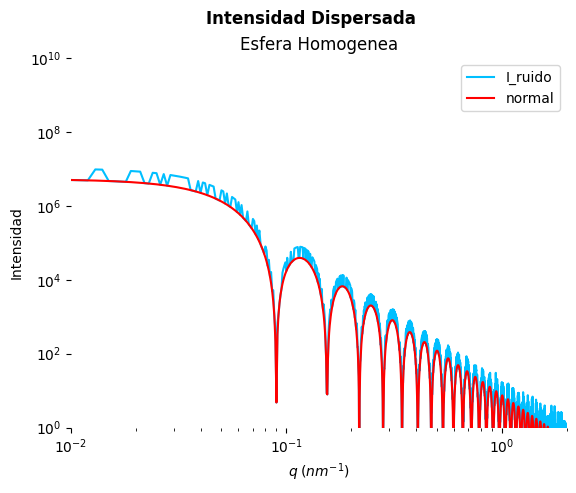

In [ ]:
R = 50
I = esfera(q, R)
ruido = np.random.poisson(I)
indices = np.arange(ruido.size)
I_ruido = np.array([I[i]+ruido[i]*np.random.choice([0, 1]) for i in indices])

fig, ax = plt.subplots()

fig.suptitle('Intensidad Dispersada',fontweight ="bold")
ax.set_title('Esfera Homogenea')
ax.set_ylabel('Intensidad')
ax.set_ylim(1e0,1e10)
ax.set_xlabel(r'$q\;(nm^{-1})$')
ax.set_xlim(1e-2,2)
ax.plot(q, I_ruido, c='deepskyblue', label = 'I_ruido')
ax.plot(q, I, c='red', label = 'normal')

ax.spines['top'].set_visible(False)
ax.spines['right'].set_visible(False)
ax.spines['bottom'].set_visible(False)
ax.spines['left'].set_visible(False)
ax.legend()
ax.set_xscale('log')
ax.set_yscale('log')

plt.show()

#6. Entrenamiento de la Red

# 7. Testeo de la Red

# 8. Conclusiones